In [2]:
########################################
# TESTING ElasticNetSubspaceClustering #
########################################
# - IMPORT DEL NECESSARIO
#si prova inizialmente su piccoli sample del dataset
import numpy as np 
import pandas as pd
import scipy as sp 
import matplotlib.pyplot as plt 
import seaborn as sns
from sklearn import metrics
from utility_scripts.evaluation_relative import clustering_evaluation
from subspace_clustering.cluster.selfrepresentation import ElasticNetSubspaceClustering
from subspace_clustering.cluster.selfrepresentation import SparseSubspaceClusteringOMP
from utility_scripts.dataframe_extended_class import dataframe_ext
from sklearn.manifold import TSNE

#features di interesse
features = ["Age", "IncomeNeed", "RiskPropension", 
            "ProtectionNeed", "LongTermCareNeed", "InheritanceIndex"]
#dataframe finale
df = pd.read_csv("../DatasetClientClustering.csv", 
                 engine='c', 
                 sep=',', 
                 encoding='latin-1')
df = df.drop(df.columns[list(np.arange(8))], axis=1)
df = df.drop(columns=["ClientID"])
data = dataframe_ext(df[features]).standardize().clean().df

In [4]:
#PARTO GUARDANDO IL NUMERO DI CLUSTERS VALUTANDO L'INDICE DI SILHOUETTE
#NON DA INFO PRECISE

sil_values = []
for i in range(2, 10):
    print("\r N. Clusters: ", i, end = "\r"), 
    model = ElasticNetSubspaceClustering(n_clusters = i)
    model.fit(points)
    results = model.labels_
    sil = metrics.silhouette_score(points, results)
    sil_values.append(sil)
print(sil_values)

100% (4902 of 4902) |####################| Elapsed Time: 0:01:12 Time:  0:01:12
100% (4902 of 4902) |####################| Elapsed Time: 0:01:24 Time:  0:01:24
100% (4902 of 4902) |####################| Elapsed Time: 0:01:38 Time:  0:01:38
100% (4902 of 4902) |####################| Elapsed Time: 0:01:31 Time:  0:01:31
100% (4902 of 4902) |####################| Elapsed Time: 0:01:38 Time:  0:01:38
100% (4902 of 4902) |####################| Elapsed Time: 0:01:34 Time:  0:01:34
100% (4902 of 4902) |####################| Elapsed Time: 0:01:33 Time:  0:01:33
100% (4902 of 4902) |####################| Elapsed Time: 0:01:31 Time:  0:01:31
[0.237175414784412, 0.19445670356879255, 0.19879032744955447, 0.17464052809943992, 0.1940647853744769, 0.23391230501767307, 0.20751229226696277, 0.1925122085827777]


100% (4902 of 4902) |####################| Elapsed Time: 0:00:15 Time:  0:00:15


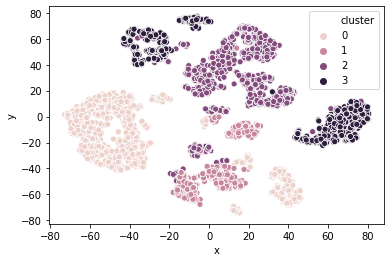

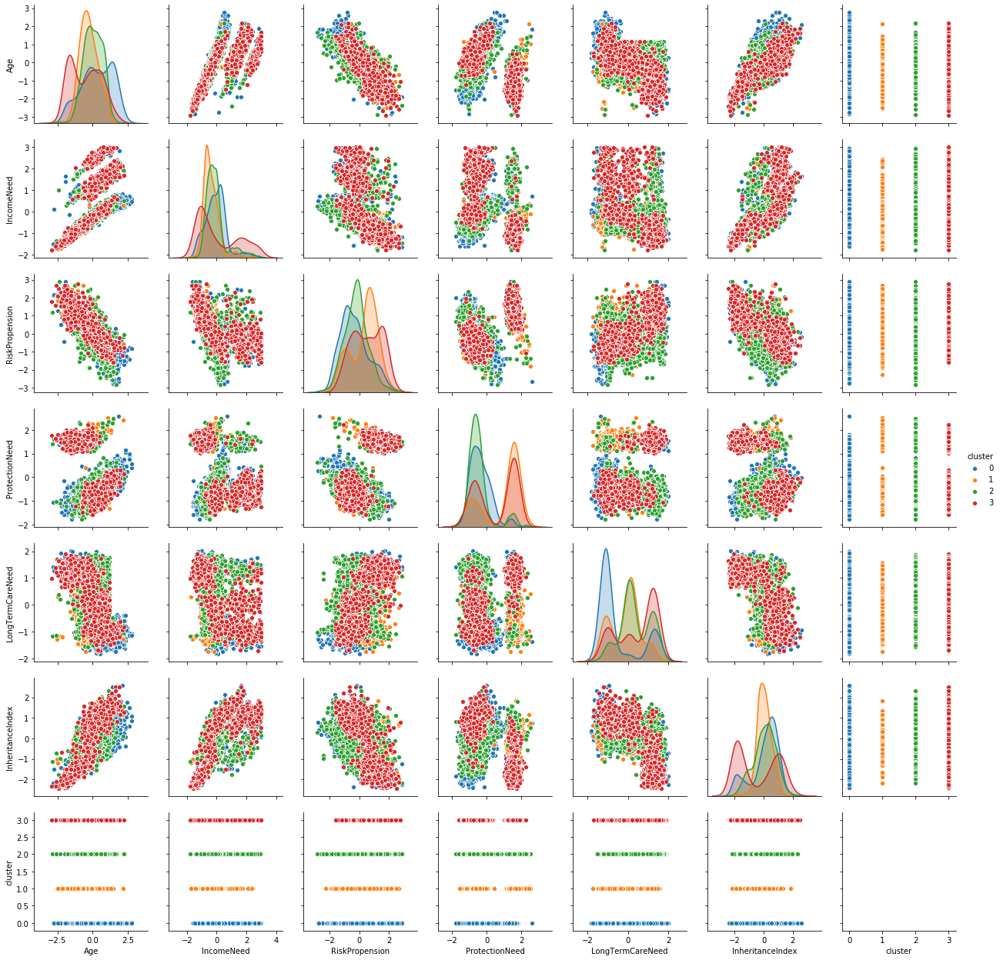

In [17]:
#VORREI GUARDARE COME SI DISTRIBUISCONO I DATI SECONDO LE LABELS
points = data.to_numpy()
model = ElasticNetSubspaceClustering(n_clusters = 4, algorithm = "lasso_cd", gamma = 30, n_jobs = -1)
model.fit(points)
results = model.labels_
data["cluster"] = results
points = data.to_numpy()
sheet = TSNE().fit_transform(points)
sheet2 = pd.DataFrame({
                            "x" : sheet[:,0], 
                            "y" : sheet[:,1], 
                            "cluster" : results
                     })
sns.scatterplot(x = "x", 
                y = "y", 
                hue = "cluster", 
                data = sheet2)
plt.show()
sns.pairplot(data, hue = "cluster")
plt.show()

In [1]:
#SI TENTA UNA SORTA DI GRID SEARCH SUL PARAMETRO GAMMA
gammas = [x for x in range(10, 101, step = 10)]
for gamma in gammas:
    points = data.to_numpy()
    model = ElasticNetSubspaceClustering(n_clusters = 4, algorithm = "lasso_cd", gamma = gamma, n_jobs = -1)
    model.fit(points)
    results = model.labels_
    points = data.to_numpy()
    sheet = TSNE().fit_transform(points)
    sheet2 = pd.DataFrame({
                                "x" : sheet[:,0], 
                                "y" : sheet[:,1], 
                                "cluster" : results
                        })
    sns.scatterplot(x = "x", 
                    y = "y", 
                    hue = "cluster", 
                    data = sheet2)
    plt.show()

NameError: name 'data' is not defined